# Energy Preserving Operator Inference Optimization Example using Periodic BC Burger's Equation

In this notebook, we conduct the numerical experiment for the energy-preserving Operator Inference (ep-OpInf) for both the hard equality constraint and soft inequality constraint.

## Packages

In [1]:
using CSV
using DataFrames
using FileIO
using JLD2
using LaTeXStrings
using LinearAlgebra
using NaNStatistics
using Plots
using ProgressMeter
using Random
using SparseArrays
using Statistics
using Tables
;

## Initial Setup

In [2]:
include("../src/model/Burgers.jl")
include("../src/LiftAndLearn.jl")
const LnL = LiftAndLearn
;

In [3]:
# First order Burger's equation setup
burger = Burgers(
    [0.0, 1.0], [0.0, 1.0], [0.05, 0.15],
    2^(-7), 1e-4, 6, "periodic"
)

# TODO: Try lower visocosity ranges
# μ = [0.005, 0.01, 0.0015, 0.002, 0.0025, 0.003]
;

In [4]:
# Create file name to save data
filename = "data/epOpInf_periodic_data_test6.jld2"
;

### Important Parameters

In [5]:
# Minimum and maximum dimensions
rmin = 1
rmax = 10

burger_system = LnL.sys_struct(
    is_lin=true,
    is_quad=true,
)
burger_vars = LnL.vars(
    N=1,
)
burger_data = LnL.data(
    Δt=1e-4,
    DS=100,
)
burger_optim = LnL.opt_settings(
    verbose=false,
    initial_guess=false,
    max_iter=1000,
    reproject=false,
    SIGE=false,
)

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Downsampling rate
DS = burger_data.DS

# Down-sampled dimension of the time data
Tdim_ds = size(1:DS:burger.Tdim, 1)  # downsampled time dimension

# Number of random test inputs
num_test_ic = 10
;

### Initial Conditions

A complex wave with a combination of exponential, cosine, and sine waves.

$$
\begin{gather*}
    x(\omega, 0) = \exp\left(-a\cos^2(\pi\omega+b) + \sin^2\left(4\pi\omega+\frac{\pi}{3}\right)+\cos^2(3\pi\omega) \right)+c
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.

In [6]:
# TEST 4, 6
# Parameters for the initial condition
ic_a = [1, 5, 9]
ic_b = [-π/4, 0, π/4]
ic_c = [-0.5, 0, 0.5]
ic_a_out = [0.01, 20]
ic_b_out = [-π/2, π/2]
ic_c_out = [-1.0, 1.0]
num_ic_params = Int(length(ic_a)*length(ic_b)*length(ic_c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(π .* burger.x .+ b).^2 .+ sin.(4*π .* burger.x .+ π/3).^2 .- cos.(3*π .* burger.x).^2) .+ c
;

A combination of exponential and cosine initial condition:


$$
\begin{gather*}
    x(\omega, 0) = \exp(-a\cos^2(\pi x+b)) - c
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.

In [6]:
# TEST 3
# Parameters for the initial condition
ic_a = [2, 4, 6]
ic_b = [-0.5, 0, 0.5]
ic_c = [-0.25, 0, 0.25]
ic_a_out = [0.1, 8]
ic_b_out = [-0.8, 0.8]
ic_c_out = [-0.5, 0.5]
num_ic_params = Int(length(ic_a)*length(ic_b)*length(ic_c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(π .* burger.x .+ b).^2) .- c
;

Initial condition to sinusoidal wave with three parameters: amplitude ($A$), frequency ($a$), and phase ($b$)

$$
\begin{gather*}
    x(\omega, 0) = A\sin(2\pi f\omega + \phi)
\end{gather*}
$$

For the convenience of code, we designate the variables $a = A$, $b = f$, and $c = \phi$.

In [6]:
# TEST 1, 2
# Parameters of the initial condition
ic_a = [0.8, 1.0, 1.2]
ic_b = [1, 2, 3]
ic_c = [-0.5, 0, 0.5]
num_ic_params = Int(length(ic_a) * length(ic_b) * length(ic_c))

# Parameterized function for the initial condition
init_wave = (A,a,b) -> A .* sin.(2 * pi * a * burger.x .+ b) 
;  

A combination of exponential and cosine initial condition:


$$
\begin{gather*}
    x(\omega, 0) = \exp(-a\cos^2(\left\lceil b \right\rceil \pi x+c)) - 0.4
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.


In [6]:
# TEST 5
# Parameters for the initial condition
ic_a = [1, 4, 7]
ic_b = [2, 4, 6]
ic_c = [-π/4, 0, π/4]
ic_a_out = [0.01, 10]
ic_b_out = [0.01, 8]
ic_c_out = [-π/2, π/2]
num_ic_params = Int(length(ic_a)*length(ic_b)*length(ic_c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(ceil(b) .* π .* burger.x .+ c).^2) .- 0.4
;

## Generate Training Data

In [8]:
# Store values
Xtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training state data 10x1
Rtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training derivative data 10x1
Xtr_all = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_ic_params)  # all training data 10x27
IC_train = Vector{Vector{Float64}}(undef, num_ic_params)  # all initial conditions 
Vrmax = Vector{Matrix{Float64}}(undef, burger.Pdim)  # POD basis 10x1
op_fom_tr = Vector{LnL.operators}(undef, burger.Pdim)  # FOM operators 10x1

@info "Generate the FOM system matrices and training data."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A, F = burger.generateEPmatrix(burger, μ)
    op_fom_tr[i] = LnL.operators(A=A, F=F)

    # Store the training data 
    Xall = Vector{Matrix{Float64}}(undef, num_ic_params)
    Xdotall = Vector{Matrix{Float64}}(undef, num_ic_params)
    
    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for a in ic_a, b in ic_b, c in ic_c
        if i == 1
            IC_train[ct] = init_wave(a, b, c)
        end

        states = burger.semiImplicitEuler(A, F, burger.t, IC_train[ct])
        Xtr_all[i,ct] = states
        
        tmp = states[:, 2:end]
        Xall[ct] = tmp[:, 1:DS:end]  # downsample data
        tmp = (states[:, 2:end] - states[:, 1:end-1]) / burger.Δt
        Xdotall[ct] = tmp[:, 1:DS:end]  # downsample data

        ct += 1  # increment counter
    end
    # Combine all initial condition data to form on big training data matrix
    Xtr[i] = reduce(hcat, Xall) 
    Rtr[i] = reduce(hcat, Xdotall)
    
    # Compute the POD basis from the training data
    tmp = svd(Xtr[i])
    Vrmax[i] = tmp.U[:, 1:rmax]
end

Data = Dict("Xtr" => Xtr, "Rtr" => Rtr, "Vrmax" => Vrmax, 
        "op_fom_tr" => op_fom_tr, 
        "Xtr_all" => Xtr_all, "IC_train" => IC_train)
@save filename Data

┌ Info: Generate the FOM system matrices and training data.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:9
Progress:  33%|██████████████                           |  ETA: 1:01:27

Progress:  50%|█████████████████████                    |  ETA: 0:46:20

Progress:  67%|████████████████████████████             |  ETA: 0:31:03

Progress:  83%|███████████████████████████████████      |  ETA: 0:15:36

Progress: 100%|█████████████████████████████████████████| Time: 1:33:57


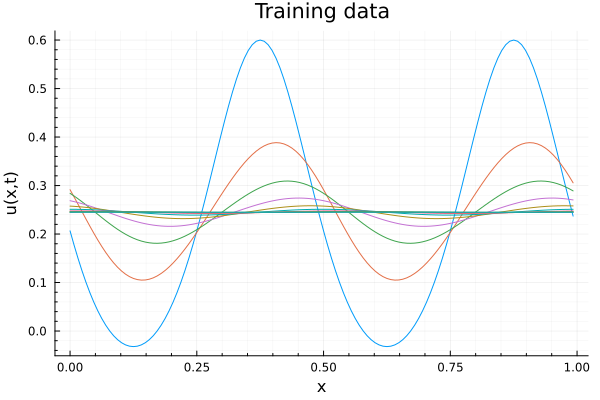

In [9]:
p1 = plot()
for i in 1:1000:burger.Tdim
    plot!(p1, burger.x, Xtr_all[1,1][:, i])
end
plot!(p1, xlabel="x", ylabel="u(x,t)", title="Training data", grid=true,
    minorgrid=true, legend=false)

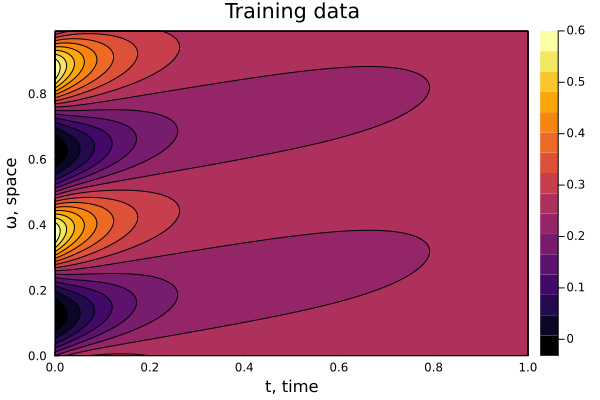

In [10]:
plot(contour(burger.t, burger.x, Xtr_all[1,1], fill=true), xlabel="t, time", ylabel="ω, space", zlabel="u(x,t)", title="Training data")

## Generate Test Data (Inside Training Region)

10 random amplitude, frequency, and phase from the training region for $\mu \in M$.


In [11]:
# Store values
Xtest_in = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_in = Vector{Vector{Float64}}(undef, num_test_ic)  # all initial conditions

@info "Generate test data for parameters within the training region."

# Generate 10 random amplitude, frequency, and phase values
# AMP_test = (maximum(AMP) - minimum(AMP)) .* rand(num_test_ic) .+ minimum(AMP)
# FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
# PHASE_test = (maximum(PHASE) - minimum(PHASE)) .* rand(num_test_ic) .+ minimum(PHASE)

# Generate 10 random initial condition parameters
ic_a_rand_in = (maximum(ic_a) - minimum(ic_a)) .* rand(num_test_ic) .+ minimum(ic_a)
ic_b_rand_in = (maximum(ic_b) - minimum(ic_b)) .* rand(num_test_ic) .+ minimum(ic_b)
ic_c_rand_in = (maximum(ic_c) - minimum(ic_c)) .* rand(num_test_ic) .+ minimum(ic_c)

@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate the data for all combinations of the initial condition parameters
    for j in 1:num_test_ic  
        a = ic_a_rand_in[j]
        b = ic_b_rand_in[j]
        c = ic_c_rand_in[j]

        if i == 1
            IC_test_in[j] = init_wave(a, b, c)
        end
        Xtest_in[i,j] = burger.semiImplicitEuler(A, F, burger.t, IC_test_in[j])
    end
end

Data["Xtest_in"] = Xtest_in
Data["IC_test_in"] = IC_test_in
@save filename Data

┌ Info: Generate test data for parameters within the training region.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:5


Progress:  33%|██████████████                           |  ETA: 0:23:36

Progress:  50%|█████████████████████                    |  ETA: 0:17:44

Progress:  67%|████████████████████████████             |  ETA: 0:11:50

Progress:  83%|███████████████████████████████████      |  ETA: 0:05:56

Progress: 100%|█████████████████████████████████████████| Time: 0:35:34


## Generate Test Data (Outside Training Region)

10 random amplitude, frequency, and phase outside of the training region for $\mu \in M$.



In [12]:
# Store values
Xtest_out = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_out = Vector{Vector{Float64}}(undef, num_test_ic)  # all initial conditions

@info "Generate test data for parameters outside the training region."

# Generate 10 random amplitude, frequency, and phase values
# AMP_test = (minimum(AMP) - 0.2) .* rand(num_test_ic/2) .+ 0.2
# append!(AMP_test, (1.8 - maximum(AMP)) .* rand(num_test_ic/2) .+ maximum(AMP))
# FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
# PHASE_test = (minimum(PHASE) - 1.0) .* rand(num_test_ic/2) .- 1.0
# append!(PHASE_test, (1.0 - maximum(PHASE)) .* rand(num_test_ic/2) .+ maximum(PHASE))

# Generate 10 random initial condition parameters outside the training region
ϵ=1e-2
half_num_test_ic = Int(num_test_ic/2)
ic_a_rand_out = ((minimum(ic_a) - ϵ) - ic_a_out[1]) .* rand(half_num_test_ic) .+ ic_a_out[1]
append!(ic_a_rand_out, (ic_a_out[2] - (maximum(ic_a) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_a) + ϵ))
ic_b_rand_out = ((minimum(ic_b) - ϵ) - ic_b_out[1]) .* rand(half_num_test_ic) .+ ic_b_out[1]
append!(ic_b_rand_out, (ic_b_out[2] - (maximum(ic_b) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_b) + ϵ))
ic_c_rand_out = ((minimum(ic_c) - ϵ) - ic_c_out[1]) .* rand(half_num_test_ic) .+ ic_c_out[1]
append!(ic_c_rand_out, (ic_c_out[2] - (maximum(ic_c) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_c) + ϵ))

@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate the data for all combinations of the initial condition parameters
    for j in 1:num_test_ic
        a = ic_a_rand_out[j]
        b = ic_b_rand_out[j]
        c = ic_c_rand_out[j]

        if i == 1
            IC_test_out[j] = init_wave(a, b, c)
        end
        Xtest_out[i,j] = burger.semiImplicitEuler(A, F, burger.t, IC_test_out[j])
    end
end

Data["Xtest_out"] = Xtest_out
Data["IC_test_out"] = IC_test_out
@save filename Data

┌ Info: Generate test data for parameters outside the training region.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:5


Progress:  33%|██████████████                           |  ETA: 0:23:53

Progress:  50%|█████████████████████                    |  ETA: 0:17:54

Progress:  67%|████████████████████████████             |  ETA: 0:11:56

Progress:  83%|███████████████████████████████████      |  ETA: 0:05:59

Progress: 100%|█████████████████████████████████████████| Time: 0:35:44


## Obtain OpInf Least-Squares Operators

In [13]:
@info "Compute the Least Squares solution."

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    pinv_tol = 1e-4,          # tolerance for pseudo-inverse
)

# Store values
op_LS = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    @info "Data loaded."
end

@showprogress for i in 1:length(burger.μs)
    op_LS[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
end

# Save to data
Data["op_LS"] = op_LS
save(filename, Data)

┌ Info: Compute the Least Squares solution.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
Progress:  33%|██████████████                           |  ETA: 0:00:10

┌ Warning: Rank difficient, rank = 65, tol = 4.492244352950396e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 63, tol = 7.551769750450984e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 62, tol = 9.795923604387675e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress: 100%|█████████████████████████████████████████| Time: 0:00:04


## Obtain intrusive operators 

In [14]:
@info "Compute the intrusive model"

# Store values
op_int = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Vrmax = Data["Vrmax"]
    op_fom_tr = Data["op_fom_tr"]
    @info "Data loaded."
end

for i in 1:length(burger.μs)
    # Compute the values for the intrusive model from the basis of the training data
    op_int[i] = LnL.intrusiveMR(op_fom_tr[i], Vrmax[i], options)
    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_int"] = op_int
save(filename, Data)

┌ Info: Compute the intrusive model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 5 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21


## Obtain operators for EPHEC-OpInf

In [12]:
@info "Compute the EPHEC model"

options = LnL.EPHEC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from data file..."
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# for i in 1:length(burger.μs)
#     if test == 1
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_tmp = LnL.operators()
#         for j in rmin:rmax
#             if j == rmin
#                 options.optim.initial_guess = false
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options)
#             else
#                 options.optim.initial_guess = true
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, op_tmp)
#             end

#             if j != rmax
#                 op_tmp.A = [op_tmp.A zeros(j, 1); zeros(1, j+1)]
#                 op_tmp.F = Matrix(LnL.insert2F(op_tmp.F, j+1))
#             else
#                 op_ephec_opinf[i] = op_tmp
#             end
#         end
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_ephec = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_ephec[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_ephec[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_ephec[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_ephec"] = op_ephec
save(filename, Data)

┌ Info: Compute the EPHEC model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139



******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************



┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.2200000286102295
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.6263907198460666e6
│ objective_value      = 892.8490902368413
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:69
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.01900005340576172
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.976271162479807e6
│ objective_value      = 472.8177672190206
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.07500004768371582
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 2.5212970030377763e6
│ objective_value      = 342.4340187142402
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:69
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.04999995231628418
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 3.2147960290416325e6
│ objective_value      = 276.4546899755978
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpIn

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.020999908447265625
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.0411968792193416e6
│ objective_value      = 236.56108904200624
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.02200007438659668
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.993841968335099e6
│ objective_value      = 217.57610892036013
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

## Obtain operators for EPSIC-OpInf

In [13]:
@info "Compute the EPSIC OpInf."

options = LnL.EPSIC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    ϵ=1e-3,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the epsic-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = false
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
#     elseif test == 3
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epsic = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epsic[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epsic[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epsic[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epsic"] = op_epsic
save(filename, Data)

┌ Info: Compute the EPSIC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.2569999694824219
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.6263872130196595e6
│ objective_value      = 889.0507852880773
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.14999985694885254
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.9762694153739172e6
│ objective_value      = 470.9063031663129
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313


┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.12199997901916504
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 2.5212958336972506e6
│ objective_value      = 341.14596965334346
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.11400008201599121
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 3.214795165110038e6
│ objective_value      = 275.490201772866
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.10399985313415527
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.04119624574154e6
│ objective_value      = 235.8337704850723
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 5 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.09800004959106445
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.993841450936462e6
│ objective_value      = 216.97894236457464
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57


## Obtain operators for EPP-OpInf

In [14]:
@info "Compute the EPUC OpInf."

options = LnL.EPP_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    α=1e6,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    # op_guess = test==3 ? Data["op_rand"] : nothing
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the EPUC-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = true
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epp = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epp[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epp[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epp[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epp"] = op_epp
save(filename, Data)

┌ Info: Compute the EPUC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.011999845504760742
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.6263907198460666e6
│ objective_value      = 892.7808996066451
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.015000104904174805
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 1.976271162479807e6
│ objective_value      = 472.79504794534296
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 2.5212970030377763e6
│ objective_value      = 342.4227132004453
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.01100015640258789
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 3.2147960290416325e6
│ objective_value      = 276.4457182921469
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\0

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.0411968792193416e6
│ objective_value      = 236.55407184362411
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLe

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 10
│ solve time           = 0.02500009536743164
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 4.993841968335099e6
│ objective_value      = 217.57029724121097
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLear

## Analyze Training Data

### Function

In [7]:
function EP_analyze(Data,burger,options,X_all,IC,rmin,rmax)

    # Projection error
    PE_all = zeros(rmax - (rmin-1), burger.Pdim) 
    # Relative state error
    SE_all = Dict(
        :int => zeros(rmax-rmin+1, burger.Pdim),
        :LS => zeros(rmax-rmin+1, burger.Pdim),
        :ephec => zeros(rmax-rmin+1, burger.Pdim),
        :epsic => zeros(rmax-rmin+1, burger.Pdim),
        :epp => zeros(rmax-rmin+1, burger.Pdim),
    )
    # Energy 
    EN_all = Dict(
        :int => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{VecOrMat{Float64}}(undef, burger.Pdim)
    )
    # Constraint Residual
    CR_all = Dict(
        :int => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{Float64}(undef, burger.Pdim)
    )
    # Momentum
    MMT_all = Dict(
        :int => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{Float64}(undef, burger.Pdim)
    )
    # Constraint Violation
    CV_all = Dict(
        :int => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{VecOrMat{Float64}}(undef, burger.Pdim)
    )

    # Load values
    op_LS = Data["op_LS"]
    op_int = Data["op_int"]
    op_ephec = Data["op_ephec"]
    op_epsic = Data["op_epsic"]
    op_epp = Data["op_epp"]
    Vrmax = Data["Vrmax"]

    num_ic_params = length(IC)

    @info "Analyze the operators with training data..."
    @showprogress for i in 1:length(burger.μs)

        # Energy, constraint residual, and constraint violation of the FOM
        EN_all[:fom][i] = norm.(eachcol(X_all[i]), 2)
        F_full = Data["op_fom_tr"][i].F
        CR_all[:fom][i], MMT_all[:fom][i] = LnL.constraintResidual(F_full, size(F_full, 1), options.optim.which_quad_term)
        CV_all[:fom][i] = LnL.constraintViolation(X_all[i], F_full, options.optim.which_quad_term)
        
        for (j,r) in enumerate(rmin:rmax)
            Vr = Vrmax[i][:, 1:r]

            # Temporary data storage
            PE = zeros(num_ic_params)  # projection error
            SE = Dict(
                :int => zeros(num_ic_params),
                :LS => zeros(num_ic_params),
                :ephec => zeros(num_ic_params),
                :epsic => zeros(num_ic_params),
                :epp => zeros(num_ic_params),
            )
            En = Dict(
                :int => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :LS => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :ephec => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epsic => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epp => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
            )
            CR = Dict(
                :int => Vector{Float64}(undef, num_ic_params),
                :LS => Vector{Float64}(undef, num_ic_params),
                :ephec => Vector{Float64}(undef, num_ic_params),
                :epsic => Vector{Float64}(undef, num_ic_params),
                :epp => Vector{Float64}(undef, num_ic_params),
            )
            mmt = Dict(
                :int => Vector{Float64}(undef, num_ic_params),
                :LS => Vector{Float64}(undef, num_ic_params),
                :ephec => Vector{Float64}(undef, num_ic_params),
                :epsic => Vector{Float64}(undef, num_ic_params),
                :epp => Vector{Float64}(undef, num_ic_params),
            )
            CV = Dict(
                :int => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :LS => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :ephec => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epsic => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epp => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
            )

            for (ct, ic) in enumerate(IC)

                # Integrate the LS operator inference model
                Finf_extract_LS = LnL.extractF(op_LS[i].F, r)
                Xinf_LS = burger.semiImplicitEuler(op_LS[i].A[1:r, 1:r], Finf_extract_LS, burger.t, Vr' * ic)

                # Integrate the intrusive model
                Fint_extract = LnL.extractF(op_int[i].F, r)
                Xint = burger.semiImplicitEuler(op_int[i].A[1:r, 1:r], Fint_extract, burger.t, Vr' * ic)
                
                if options.optim.SIGE
                    # Integrate the energy-preserving hard equality constraint operator inference model
                    Finf_extract_ephec = op_ephec[i,j].F
                    Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,j].A, op_ephec[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_ephec = LnL.extractF(op_ephec[i,rmax].F, r)
                    # Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,rmax].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * ic)
                    
                    # Integrate the energy-preserving soft inequality constraint operator inference model
                    Finf_extract_epsic = op_epsic[i,j].F
                    Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,j].A, op_epsic[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_epsic = LnL.extractF(op_epsic[i,rmax].F, r)
                    # Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,rmax].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * ic)

                    # Integrate the energy-preserving unconstrained operator inference model
                    Finf_extract_epp = op_epp[i,j].F
                    Xinf_epp = burger.semiImplicitEuler(op_epp[i,j].A, op_epp[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_epuc = LnL.extractF(op_epuc[i,rmax].F, r)
                    # Xinf_epuc = burger.semiImplicitEuler(op_epuc[i,rmax].A[1:r, 1:r], Finf_extract_epuc, burger.t, Vr' * ic)
                else
                    # Integrate the energy-preserving hard equality constraint operator inference model
                    Finf_extract_ephec = LnL.extractF(op_ephec[i].F, r)
                    Xinf_ephec = burger.semiImplicitEuler(op_ephec[i].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * ic)
                    
                    # Integrate the energy-preserving soft inequality constraint operator inference model
                    Finf_extract_epsic = LnL.extractF(op_epsic[i].F, r)
                    Xinf_epsic = burger.semiImplicitEuler(op_epsic[i].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * ic)

                    # Integrate the energy-preserving unconstrained operator inference model
                    Finf_extract_epp = LnL.extractF(op_epp[i].F, r)
                    Xinf_epp = burger.semiImplicitEuler(op_epp[i].A[1:r, 1:r], Finf_extract_epp, burger.t, Vr' * ic)
                end

                # Compute the projection error
                PE[ct] = LnL.compProjError(X_all[i,ct], Vr)

                # Compute the relative state error
                SE[:LS][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_LS[:, 1:DS:end], Vr)
                SE[:int][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xint[:, 1:DS:end], Vr)
                SE[:ephec][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_ephec[:, 1:DS:end], Vr)
                SE[:epsic][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_epsic[:, 1:DS:end], Vr)
                SE[:epp][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_epp[:, 1:DS:end], Vr)

                # Compute the energy
                En[:LS][ct, :] .= norm.(eachcol(Vr * Xinf_LS), 2)
                En[:int][ct, :] .= norm.(eachcol(Vr * Xint), 2)
                En[:ephec][ct, :] .= norm.(eachcol(Vr * Xinf_ephec), 2)
                En[:epsic][ct, :] .= norm.(eachcol(Vr * Xinf_epsic), 2)
                En[:epp][ct, :] .= norm.(eachcol(Vr * Xinf_epp), 2)

                # Compute the constraint residual and momentum
                CR[:LS][ct], mmt[:LS][ct] =  LnL.constraintResidual(Finf_extract_LS, r, options.optim.which_quad_term)
                CR[:int][ct], mmt[:int][ct] = LnL.constraintResidual(Fint_extract, r, options.optim.which_quad_term)
                CR[:ephec][ct], mmt[:ephec][ct] = LnL.constraintResidual(Finf_extract_ephec, r, options.optim.which_quad_term)
                CR[:epsic][ct], mmt[:epsic][ct] = LnL.constraintResidual(Finf_extract_epsic, r, options.optim.which_quad_term)
                CR[:epp][ct], mmt[:epp][ct] = LnL.constraintResidual(Finf_extract_epp, r, options.optim.which_quad_term)

                # Compute the constraint violation
                CV[:LS][ct, :] .= LnL.constraintViolation(Xinf_LS, Finf_extract_LS, options.optim.which_quad_term)
                CV[:int][ct, :] .= LnL.constraintViolation(Xint, Fint_extract, options.optim.which_quad_term)
                CV[:ephec][ct, :] .= LnL.constraintViolation(Xinf_ephec, Finf_extract_ephec, options.optim.which_quad_term)
                CV[:epsic][ct, :] .= LnL.constraintViolation(Xinf_epsic, Finf_extract_epsic, options.optim.which_quad_term)
                CV[:epp][ct, :] .= LnL.constraintViolation(Xinf_epp, Finf_extract_epp, options.optim.which_quad_term)
            end

            # Compute errors
            PE_all[j, i] = mean(PE)
            SE_all[:LS][j, i] = mean(SE[:LS])
            SE_all[:int][j, i] = mean(SE[:int])
            SE_all[:ephec][j, i] = mean(SE[:ephec])
            SE_all[:epsic][j, i] = mean(SE[:epsic])
            SE_all[:epp][j, i] = mean(SE[:epp])
            
            # Compute energy 
            EN_all[:LS][j, i] = mean(En[:LS], dims=1)
            EN_all[:int][j, i] = mean(En[:int], dims=1)
            EN_all[:ephec][j, i] = mean(En[:ephec], dims=1)
            EN_all[:epsic][j, i] = mean(En[:epsic], dims=1)
            EN_all[:epp][j, i] = mean(En[:epp], dims=1)
            
            # Compute the CR and momentum
            CR_all[:LS][j, i] = mean(CR[:LS])
            CR_all[:int][j, i] = mean(CR[:int])
            CR_all[:ephec][j, i] = mean(CR[:ephec])
            CR_all[:epsic][j, i] = mean(CR[:epsic])
            CR_all[:epp][j, i] = mean(CR[:epp])

            MMT_all[:LS][j, i] = mean(mmt[:LS])
            MMT_all[:int][j, i] = mean(mmt[:int])
            MMT_all[:ephec][j, i] = mean(mmt[:ephec])
            MMT_all[:epsic][j, i] = mean(mmt[:epsic])
            MMT_all[:epp][j, i] = mean(mmt[:epp])

            # Compute constraint violations
            CV_all[:LS][j, i] = mean(CV[:LS], dims=1)
            CV_all[:int][j, i] = mean(CV[:int], dims=1)
            CV_all[:ephec][j, i] = mean(CV[:ephec], dims=1)
            CV_all[:epsic][j, i] = mean(CV[:epsic], dims=1)
            CV_all[:epp][j, i] = mean(CV[:epp], dims=1)
        end
    end

    return PE_all, SE_all, EN_all, CR_all, MMT_all, CV_all
end
;

In [10]:
Data["train_proj_err"], Data["train_state_err"], Data["train_En"], Data["train_CR"], Data["train_mmt"], Data["train_CV"] = EP_analyze(Data,burger,options,Data["Xtr_all"],Data["IC_train"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60
Progress:  33%|██████████████                           |  ETA: 0:02:57

Progress:  50%|█████████████████████                    |  ETA: 0:02:12

Progress:  67%|████████████████████████████             |  ETA: 0:01:27

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:43

Progress: 100%|█████████████████████████████████████████| Time: 0:04:20


In [17]:
save(filename, Data)

### Results

In [5]:
# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    @info "Data loaded."
end
;

#### Projection Error

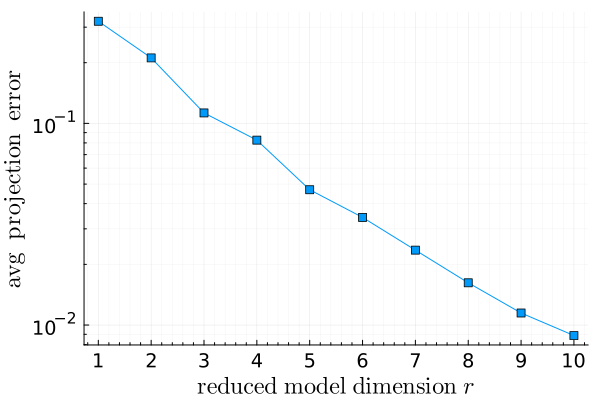

In [13]:
# Training data
mean_train_proj_err = mean(Data["train_proj_err"], dims=2)
plot(rmin:rmax, mean_train_proj_err, marker=(:rect))
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=false)
tmp = log10.(mean_train_proj_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~projection~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Mean relative state error

In [14]:
DataFrame(Data["train_state_err"][:LS], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.403385,0.363311,0.333745,0.311116,0.293193,0.278595
2,0.318706,0.268861,0.237007,0.215598,0.20046,0.189272
3,0.16688,0.146307,0.134425,0.126746,0.121489,0.11775
4,0.12791,0.11331,0.102343,0.0937503,0.0880131,0.0842513
5,0.0834013,0.0648272,0.0552285,0.049811,0.0466289,0.044526
6,0.0607365,0.0497402,0.0426173,0.0374465,0.0338417,0.0312206
7,0.0420774,0.0347137,0.0302578,0.027373,0.0250104,0.0232272
8,0.0277073,0.02272,0.0202414,0.0186887,0.017415,0.0162597
9,0.019959,0.015945,0.0139149,0.0127406,0.0119832,0.0113948


In [15]:
DataFrame(Data["train_state_err"][:int], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.403385,0.363311,0.333745,0.311116,0.293193,0.278594
2,0.318738,0.268749,0.236945,0.215621,0.200512,0.189306
3,0.167191,0.14656,0.134653,0.126824,0.121342,0.117356
4,0.128218,0.113323,0.102366,0.0939011,0.0879192,0.0835222
5,0.0831512,0.0646661,0.0551505,0.0496259,0.046117,0.0437234
6,0.0600501,0.049167,0.0419535,0.0367253,0.0331307,0.0305339
7,0.041334,0.0340451,0.0296823,0.0268679,0.0248837,0.0233144
8,0.0274728,0.0224235,0.019884,0.0182861,0.0171166,0.0161714
9,0.019515,0.015845,0.0140243,0.0129263,0.012191,0.0116676


In [16]:
DataFrame(Data["train_state_err"][:ephec], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.403385,0.363311,0.333745,0.311116,0.293193,0.278595
2,0.318276,0.268401,0.236754,0.215517,0.200507,0.189301
3,0.168531,0.147416,0.134971,0.126971,0.121514,0.117502
4,0.128547,0.113245,0.102693,0.0943662,0.0885438,0.0842358
5,0.0841171,0.0656481,0.0561545,0.0507489,0.0472408,0.0447595
6,0.0615147,0.0505239,0.0425893,0.0374137,0.0340442,0.0315682
7,0.0427166,0.0353688,0.0309747,0.0279205,0.0255357,0.0237136
8,0.0288024,0.0235907,0.0209093,0.0191107,0.0178341,0.0169546
9,0.020446,0.0162585,0.01424,0.0131079,0.0124409,0.0119301


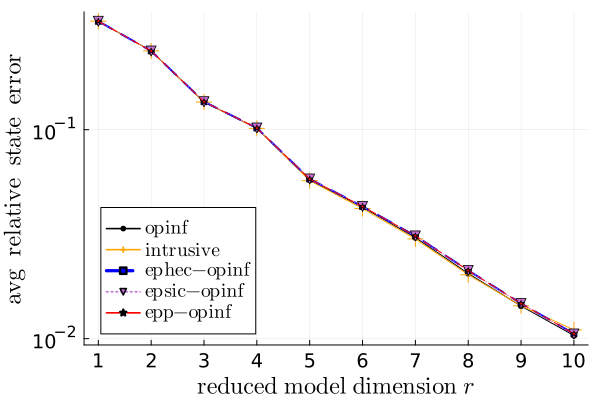

In [17]:
# Training data
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["train_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["train_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["train_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["train_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["train_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Total Energy

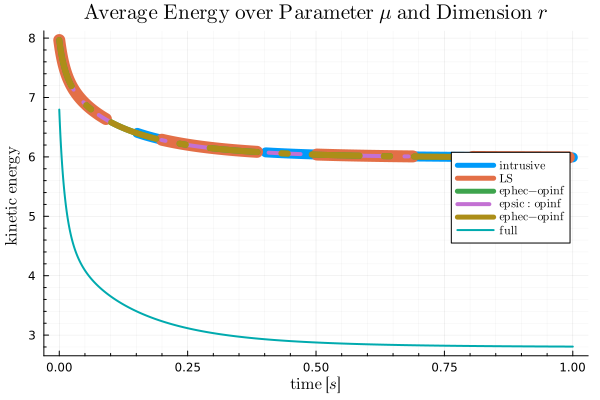

In [19]:
# Training data
mean_LS_En_tr = mean(Data["train_En"][:LS])'
mean_int_En_tr = mean(Data["train_En"][:int])'
mean_ephec_En_tr = mean(Data["train_En"][:ephec])'
mean_epsic_En_tr = mean(Data["train_En"][:epsic])'
mean_epp_En_tr = mean(Data["train_En"][:epp])'
mean_fom_En_tr = mean(Data["train_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:right)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

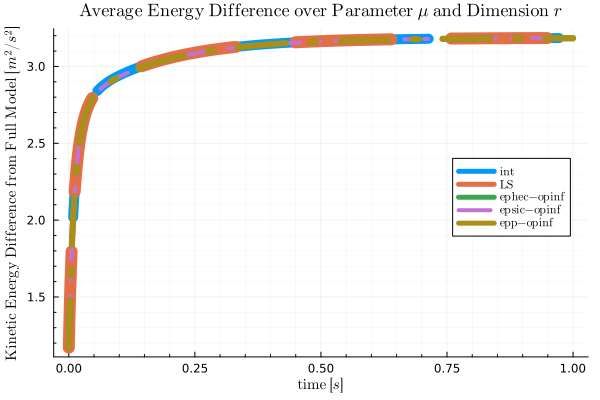

In [20]:
plot(burger.t, mean_int_En_tr - mean_fom_En_tr, lw=10, ls=:dash, label=L"\mathrm{int}")
plot!(burger.t, mean_LS_En_tr - mean_fom_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr - mean_fom_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epp_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(majorgrid=true, minorgrid=true, legend=:right)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{Kinetic~Energy~Difference~from~Full~Model}~[m^2/s^2]", fontsize=(8))
title!(L"\mathrm{Average~Energy~Difference~over~Parameter}~\mu \mathrm{~and~Dimension~} r", titlefont = font(12))
plot!(guidefontsize=10)

#### Constraint Residual 

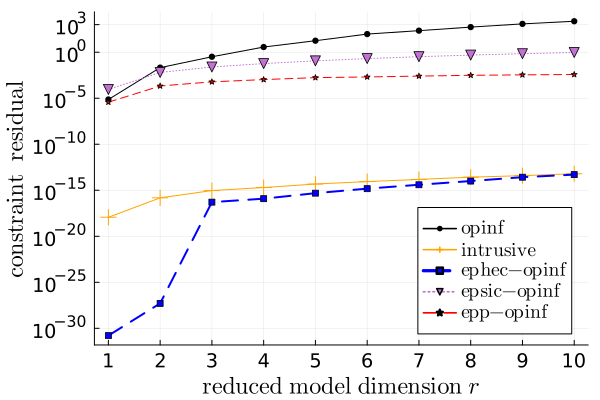

In [18]:
mean_LS_CR_tr = mean(Data["train_CR"][:LS], dims=2)
mean_int_CR_tr = mean(Data["train_CR"][:int], dims=2)
mean_ephec_CR_tr = mean(Data["train_CR"][:ephec], dims=2)
mean_epsic_CR_tr = mean(Data["train_CR"][:epsic], dims=2)
mean_epp_CR_tr = mean(Data["train_CR"][:epp], dims=2)
mean_fom_CR_tr = mean(Data["train_CR"][:fom])

plot(rmin:rmax, mean_LS_CR_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_CR_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_CR_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_CR_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_CR_tr, c=:red, marker=(:star, 3), ls=:dash, lw=1, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-30, -25, -20, -15, -10, -5, 0, 3])
xticks!(1:15)
xlabel!(L"\mathrm{reduced~model~dimension}~r")
ylabel!(L"\mathrm{constraint~~residual}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Momentum 

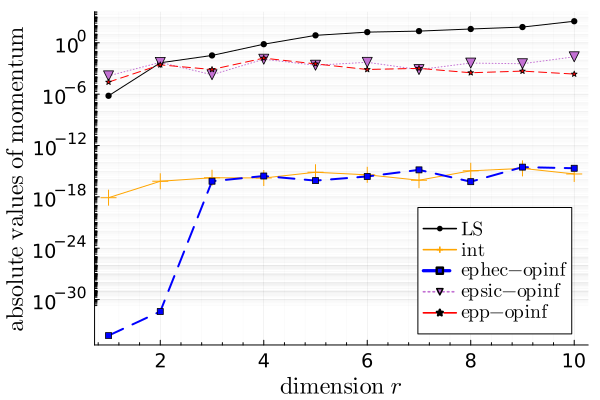

In [22]:
mean_LS_mmt_tr    = abs.(mean(Data["train_mmt"][:LS], dims=2))
mean_int_mmt_tr   = abs.(mean(Data["train_mmt"][:int], dims=2))
mean_ephec_mmt_tr = abs.(mean(Data["train_mmt"][:ephec], dims=2))
mean_epsic_mmt_tr = abs.(mean(Data["train_mmt"][:epsic], dims=2))
mean_epp_mmt_tr = abs.(mean(Data["train_mmt"][:epp], dims=2))
mean_fom_mmt_tr   = abs.(mean(Data["train_mmt"][:fom]))

plot(rmin:rmax, mean_LS_mmt_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{LS}")
plot!(rmin:rmax, mean_int_mmt_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{int}")
plot!(rmin:rmax, mean_ephec_mmt_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_mmt_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_mmt_tr, c=:red, marker=(:star, 3), ls=:dash, lw=1, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-30, -24, -18, -12, -6, 0, 6])
xlabel!(L"\mathrm{dimension}~r")
ylabel!(L"\mathrm{absolute~values~of~momentum}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Constraint Violation

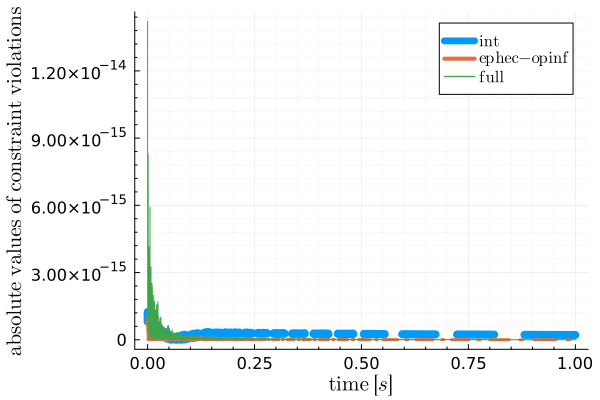

In [23]:
# Training data
mean_LS_CV_tr    = abs.(mean(Data["train_CV"][:LS]))'
mean_int_CV_tr   = abs.(mean(Data["train_CV"][:int]))'
mean_ephec_CV_tr = abs.(mean(Data["train_CV"][:ephec]))'
mean_epsic_CV_tr = abs.(mean(Data["train_CV"][:epsic]))'
mean_epp_CV_tr = abs.(mean(Data["train_CV"][:epp]))'
mean_fom_CV_tr   = abs.(mean(Data["train_CV"][:fom]))

plot(burger.t, mean_int_CV_tr, lw=8, ls=:dash, label=L"\mathrm{int}")
# plot!(burger.t, mean_LS_CV_tr, lw=6, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_CV_tr, lw=3, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epp_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_CV_tr, lw=1, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
# yticks!(10.0 .^ [-24, -21, -18, -15, -12, -9, -6, -3, 0])
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{absolute~values~of~constraint~violations}")
plot!(guidefontsize=14, tickfontsize=11,  legendfontsize=11)

## Test 1: Inside Training Region

In [11]:
# Load the data dictionary
_, Data["test1_state_err"], Data["test1_En"], _, _, _ = EP_analyze(Data,burger,options,Data["Xtest_in"],Data["IC_test_in"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60
Progress:  33%|██████████████                           |  ETA: 0:01:07

Progress:  67%|████████████████████████████             |  ETA: 0:00:33

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:17

Progress: 100%|█████████████████████████████████████████| Time: 0:01:40


In [ ]:
@save filename Data

### Results

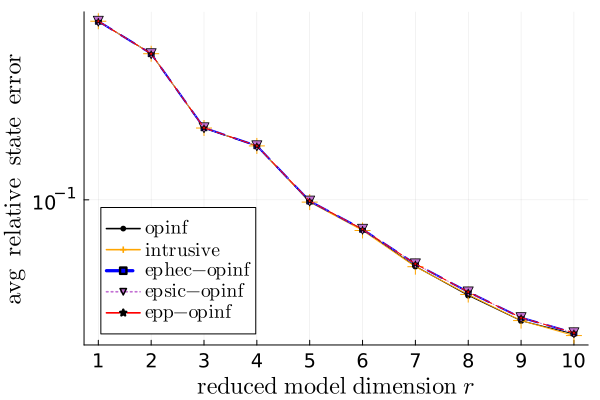

In [19]:
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["test1_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test1_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test1_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test1_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test1_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

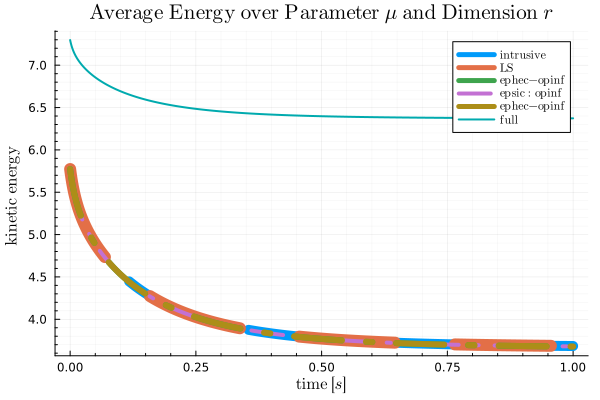

In [25]:
mean_LS_En_tr = mean(Data["test1_En"][:LS])'
mean_int_En_tr = mean(Data["test1_En"][:int])'
mean_ephec_En_tr = mean(Data["test1_En"][:ephec])'
mean_epsic_En_tr = mean(Data["test1_En"][:epsic])'
mean_epp_En_tr = mean(Data["test1_En"][:epp])'
mean_fom_En_tr = mean(Data["test1_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

## Test 2: Outside Training Region

In [12]:
# Load the data dictionary
_, Data["test2_state_err"], Data["test2_En"], _, _, _ = EP_analyze(Data,burger,options,Data["Xtest_out"],Data["IC_test_out"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60


Progress:  50%|█████████████████████                    |  ETA: 0:00:51

Progress:  67%|████████████████████████████             |  ETA: 0:00:34

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:17

Progress: 100%|█████████████████████████████████████████| Time: 0:01:41


In [21]:
save(filename, Data)

### Results

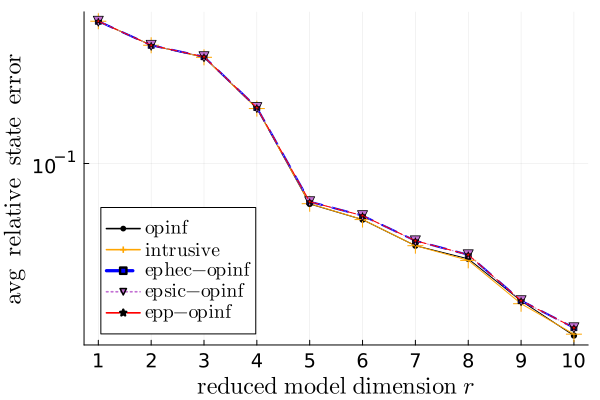

In [20]:
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["test2_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test2_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test2_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test2_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test2_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)


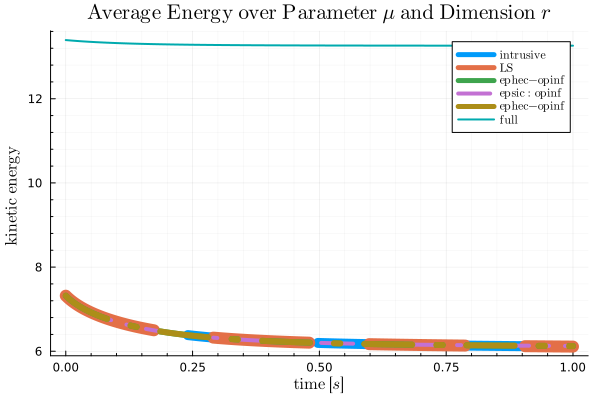

In [70]:
# Training data
mean_LS_En_tr = mean(Data["test2_En"][:LS])'
mean_int_En_tr = mean(Data["test2_En"][:int])'
mean_ephec_En_tr = mean(Data["test2_En"][:ephec])'
mean_epsic_En_tr = mean(Data["test2_En"][:epsic])'
mean_epp_En_tr = mean(Data["test2_En"][:epp])'
mean_fom_En_tr = mean(Data["test2_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

## Plot Test 1 and Test 2 together

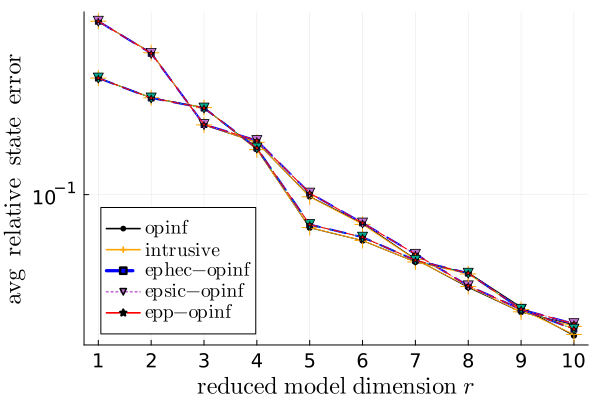

In [44]:
c1,c2,c3,c4,c5 = palette(:default)

# Test 1
mean_LS_state_err = mean(Data["test1_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test1_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test1_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test1_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test1_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")

# Test 2
mean_LS_state_err = mean(Data["test2_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test2_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test2_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test2_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test2_state_err"][:epp], dims=2)

plot!(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label="")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label="")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label="")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label="")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label="")

plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)
